# Explorando o DataSet

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import re
import ast
from collections import Counter

In [437]:
path_2021 = r"..\bases\State of Data 2021 - Dataset - Pgina1.csv"
path_2022 = r"..\bases\State_of_data_2022.csv"
path_2023 = r"..\bases\State_of_data_BR_2023_Kaggle - df_survey_2023.csv"

dados_2021 = pd.read_csv(path_2021)
dados_2022 = pd.read_csv(path_2022)
dados_2023 = pd.read_csv(path_2023)

C:\Users\guipi\AppData\Local\Temp\ipykernel_18216\2244422441.py:5: DtypeWarning: Columns (47) have mixed types. Specify dtype option on import or set low_memory=False.
  dados_2021 = pd.read_csv(path_2021)


In [438]:
dados_2021['Ano'] = 2021
dados_2022['Ano'] = 2022
dados_2023['Ano'] = 2023

In [439]:
dados_2021.columns = [col.split(", ", 1)[1][1:-2] if ", " in col else col for col in dados_2021.columns]
dados_2022.columns = [col.split(", ", 1)[1][1:-2] if ", " in col else col for col in dados_2022.columns]
dados_2023.columns = [col.split(", ", 1)[1][1:-2] if ", " in col else col for col in dados_2023.columns]

In [440]:
print("n de colunas 2021",len(dados_2021.columns)) 
print("n de colunas 2022",len(dados_2022.columns))
print("n de colunas 2023",len(dados_2023.columns))

colunas_2021 = set(dados_2021.columns)
colunas_2022 = set(dados_2022.columns)
colunas_2023 = set(dados_2023.columns)

n de colunas 2021 357
n de colunas 2022 354
n de colunas 2023 400


- Função para padronizar os nomes das colunas

In [441]:
# Encontrando as colunas comuns dentre os 3 datasets          
colunas_comuns = list(colunas_2021.intersection(colunas_2022, colunas_2023))
print(f"Total de colunas comuns: {len(colunas_comuns)}")
print(f"Colunas comuns: {colunas_comuns}")

Total de colunas comuns: 283
Colunas comuns: ['Desenvolvendo modelos de Machine Learning com o objetivo de colocar em produção em sistemas (produtos de dados).', 'h Conseguir gerar valor para as áreas de negócios através de estudos e experimentos.', 'Redash', 'Caso sua empresa decida pelo modelo 100% presencial qual será sua atitude?', '.NET', 'Não sei informar.', 'Sou responsável por criar e manter a infra que meus modelos e soluções rodam (clusters, servidores, API, containers, etc.)', 'MicroStrategy', 'Ferramentas de análise dentro de ferramentas de CRM como Salesforce Einstein Anaytics ou Zendesk dashboards.', 'MongoDB', 'Java', 'Não tenho uma boa relação com meu líder/gestor', 'Atuando na modelagem dos dados, com o objetivo de criar conjuntos de dados como Data Warehouses, Data Marts etc.', 'Utilizo modelos de Detecção de Churn', "Desenvolvendo/cuidando da manutenção de ETL's utilizando tecnologias como Talend, Pentaho, Airflow, Dataflow etc.", 'Apache Airflow', 'Arquiteto de Dado

- Filtrando apenas com colunas comuns

In [442]:
df_2021 = dados_2021[colunas_comuns].copy()
df_2022 = dados_2022[colunas_comuns].copy()
df_2023 = dados_2023[colunas_comuns].copy()

- Concatenando os dataframes

In [443]:
df_2021 = df_2021.loc[:, ~df_2021.columns.duplicated()]
df_2022 = df_2022.loc[:, ~df_2022.columns.duplicated()]
df_2023 = df_2023.loc[:, ~df_2023.columns.duplicated()]

In [444]:
df = pd.concat([df_2021, df_2022, df_2023], ignore_index=True)
df.shape

(12209, 283)

# Limpando o DataFrame

- Verificando valores vazios

## Removendo colunas redundantes

In [445]:
colunas_tecnologias = [
    'Faixa idade',
    'Cargo como Gestor', 
    'Regiao de origem',
    'h Conseguir gerar valor para as áreas de negócios através de estudos e experimentos.',
    'Redash',
    '.NET',
    'Sou responsável por criar e manter a infra que meus modelos e soluções rodam (clusters, servidores, API, containers, etc.)',
    'MicroStrategy',
    'Ferramentas de análise dentro de ferramentas de CRM como Salesforce Einstein Anaytics ou Zendesk dashboards.',
    'MongoDB',
    'Java',
    'Python',
    'PHP',
    'SAS/Stata',
    'Matlab',
    'Julia',
    'SQL',
    'R ',
    'Scala',
    'C/C++/C#',
    'Visual Basic/VBA',
    'SQL SERVER',
    'PostgreSQL',
    'Firebase',
    'Snowflake',
    'Firebird',
    'MySQL',
    'DB2',
    'Oracle',
    'Neo4J',
    'ElasticSearch',
    'SAP HANA',
    'Redis',
    'Cassandra',
    'MariaDB',
    'Google BigQuery',
    'Amazon Redshift',
    'CoachDB',
    'Amazon Aurora ou RDS',
    'SQLite',
    'Microsoft Access',
    'Amazon Athena',
    'Databricks',
    'Presto',
    'S3',
    'Datomic',
    'Sybase',
    'Vertica',
    'HBase',
    'Hive',
    'Google Firestore',
    'Knime',
    'Luigi',
    'Talend',
    'Apache Airflow',
    'Stitch',
    'Fivetran',
    'IBM DataStage',
    'SAP BW ETL',
    'Oracle Data Integrator',
    'AWS Glue',
    'Google Dataflow',
    'Point and Click Analytics como Alteryx, Knime, Rapidminer etc.',
    'Superset',
    'Mode',
    'Looker',
    'Tableau',
    'PowerBI',
    'Microsoft PowerBI',
    'Qlik View/Qlik Sense',
    'Grafana',
    'Metabase',
    'Pentaho',
    'TIBCO Spotfire',
    'Amazon Web Services (AWS)',
    'Azure (Microsoft)',
    'Google Cloud (GCP)',
    'IBM Analytics/Cognos',
    'SAS Visual Analytics',
    'Salesforce/Einstein Analytics',
    'Birst',
    'Ferramentas de AutoML como H2O.ai, Data Robot, BigML etc.',
    'Ferramentas de AutoML (Datarobot, H2O, Auto-Keras etc)',
    'Ambientes de desenvolvimento na nuvem (Google Colab, AWS Sagemaker, Kaggle Notebooks etc)',
    'Ambientes de desenvolvimento local (R-studio, JupyterLab, Anaconda)',
    'Ferramentas de estatística avançada como SPSS, SAS, etc.',
    'SPSS',
    'SAS',
    'Stata',
    'Ferramentas de BI (PowerBI, Looker, Tableau, Qlik etc)',
    'Ferramentas de ETL (Apache Airflow, NiFi, Stitch, Fivetran, Pentaho etc)',
    'NiFi',
    'Hopsworks',
    'Feast',
    'AWS Feature Store',
    'Databricks Feature Store',
    'Feature Store (Feast, Hopsworks, AWS Feature Store, Databricks Feature Store etc)',
    'TensorFlow',
    'Azure Machine Learning',
    'Kubeflow',
    'DVC',
    'Github',
    'Gitlab',
    'Neptune',
    'SQL Server Integration Services (SSIS)',
    'Cientista de Dados/Data Scientist',
    'Arquiteto de Dados/Data Architect',
    'Engenharia de Dados/Data Engineer',
    'Analytics Engineer',
    'Analista de Dados/Data Analyst',
    'Database Administrator/DBA',
    'Analista de Business Intelligence/BI',
    'Business Analyst',
    'Data Product Manager/DPM',
    'Quais das linguagens listadas abaixo você utiliza no trabalho?',
    'Estado onde mora',
    'id'
]


In [446]:
df = df.drop(columns=colunas_tecnologias, errors='ignore')

## Verificando valores vazios

In [447]:
nulos = df.isnull().sum().sort_values(ascending=False)

for nome, valor in nulos.items():
    print(f"{nome}: {valor}")
    print()

Qual oportunidade você está buscando?: 11423

Como tem sido a busca por um emprego na área de dados?: 11420

Há quanto tempo você busca uma oportunidade na área de dados?: 11418

Quais as ferramentas de gestão de Qualidade de dados, Metadados e catálogo de dados você utiliza no trabalho?: 11040

Qual tecnologia utilizada como plataforma do Data Warehouse?: 10630

Qual tecnologia utilizada como plataforma do Data Lake?: 10627

Utilizo modelos de Detecção de Churn: 10420

Quais das opções abaixo fazem parte da sua rotina no trabalho atual com ciência de dados?: 10420

Utilizo modelos de Machine Learning para detecção de fraude: 10420

Cuido da manutenção de modelos de Machine Learning já em produção, atuando no monitoramento, ajustes e refatoração quando necessário.: 10420

Sou responsável por colocar modelos em produção, criar os pipelines de dados, APIs de consumo e monitoramento.: 10420

Cuidando da manutenção de modelos de Machine Learning já em produção, atuando no monitoramento, aj

In [448]:
df = df[df.isnull().sum().sort_values(ascending=False).index]

In [449]:
for coluna in df.columns:
    if df[coluna].dtype == 'object':
        print(f"{coluna}: {df[coluna].isnull().mean():.2%}")
        print()

Qual oportunidade você está buscando?: 93.56%

Como tem sido a busca por um emprego na área de dados?: 93.54%

Há quanto tempo você busca uma oportunidade na área de dados?: 93.52%

Quais as ferramentas de gestão de Qualidade de dados, Metadados e catálogo de dados você utiliza no trabalho?: 90.43%

Qual tecnologia utilizada como plataforma do Data Warehouse?: 87.07%

Qual tecnologia utilizada como plataforma do Data Lake?: 87.04%

Quais das opções abaixo fazem parte da sua rotina no trabalho atual com ciência de dados?: 85.35%

Em qual das opções abaixo você gasta a maior parte do seu tempo no trabalho?: 85.35%

Quais dessas tecnologias fazem parte do seu dia a dia como cientista de dados?: 85.35%

Quais as técnicas e métodos listados abaixo você costuma utilizar no trabalho?: 85.35%

Sua organização possui um Data Warehouse?: 83.75%

Sua organização possui um Data Lake?: 83.74%

Quais as ferramentas/tecnologias de ETL que você utiliza no trabalho como Data Engineer?: 83.70%

Quais da

- Verificando os valores contidos nas colunas

In [450]:
for coluna in df.columns:
    if df[coluna].dtype == 'object':
        print(df[coluna].value_counts())
        print()
        print('-'*100)
        print()

Qual oportunidade você está buscando?
Analista de Dados/Data Analyst                                         245
Cientista de Dados/Data Scientist                                      241
Ciência de Dados/Data Scientist                                         86
Engenheiro de Dados/Arquiteto de Dados/Data Engineer/Data Architect     56
Análise de Dados/Data Analyst                                           36
Analista de BI/BI Analyst                                               25
Analista de Negócios/Business Analyst                                   23
Engenharia de Dados/Data Engineer                                       20
Engenheiro de Machine Learning/ML Engineer                              19
Business Intelligence/BI                                                10
Analytics Engineer                                                       4
Business Analyst                                                         4
Data Product Manager                                          

### Realizando a imputação dos valores vazios

- Imputando os valores com mais da metade vazios

In [451]:
valores_imputacao = {
    "Quais as ferramentas de gestão de Qualidade de dados, Metadados e catálogo de dados você utiliza no trabalho?": "Nenhuma das opções listadas refletem meu dia a dia.",
    "Qual tecnologia utilizada como plataforma do Data Warehouse?": "Nenhuma das opções listadas refletem meu dia a dia.",
    "Qual tecnologia utilizada como plataforma do Data Lake?": "Nenhuma das opções listadas refletem meu dia a dia.",
    "Em qual das opções abaixo você gasta a maior parte do seu tempo no trabalho?": "Nenhuma das opções listadas refletem meu dia a dia.",
    "Qual o principal motivo da sua insatisfação com a empresa atual?": "Nenhuma das opções listadas refletem meu dia a dia.",
    "Quais as ferramentas/tecnologias de ETL que você utiliza no trabalho como Data Analyst?": "Nenhuma das opções listadas refletem meu dia a dia.",
    "Em qual das opções abaixo você gasta a maior parte do seu tempo de trabalho?": "Nenhuma das opções listadas refletem meu dia a dia.",
    "Sua empresa utiliza alguma das ferramentas listadas para dar mais autonomia em análise de dados para as áreas de negócio?": "Nenhuma das opções listadas refletem meu dia a dia.",
    "Quais das opções abaixo fazem parte da sua rotina no trabalho atual com análise de dados?": "Nenhuma das opções listadas refletem meu dia a dia.",
    "Quais das opções abaixo fazem parte da sua rotina no trabalho atual com ciência de dados?": "Nenhuma das opções listadas refletem meu dia a dia.",
    "Quais dessas tecnologias fazem parte do seu dia a dia como cientista de dados?": "Nenhuma das opções listadas refletem meu dia a dia.",
    "Quais as técnicas e métodos listados abaixo você costuma utilizar no trabalho?": "Nenhuma das opções listadas refletem meu dia a dia.",
    "Quais as ferramentas/tecnologias de ETL que você utiliza no trabalho como Data Engineer?": "Nenhuma das opções listadas refletem meu dia a dia.",
    "Quais das opções abaixo fazem parte da sua rotina no trabalho atual como engenheiro de dados?": "Nenhuma das opções listadas refletem meu dia a dia.",
    "Em qual das opções abaixo você gasta a maior parte do seu tempo?": "Nenhuma das opções listadas refletem meu dia a dia.",
    "Quais desses papéis/cargos fazem parte do time (ou chapter) de dados da sua empresa?": "Nenhuma das opções listadas refletem meu dia a dia.",
    "Qual oportunidade você está buscando?": "não estou procurando",
    "Como tem sido a busca por um emprego na área de dados?": "não estou procurando",
    "Há quanto tempo você busca uma oportunidade na área de dados?": "não estou procurando",
    "Quais são os 3 maiores desafios que você tem como gestor no atual momento?": "não sou gestor",
    "Quais dessas responsabilidades fazem parte da sua rotina atual de trabalho como gestor?": "não sou gestor",
    "Mesmo que esse não seja seu cargo formal, você considera que sua atuação no dia a dia, reflete alguma das opções listadas abaixo?":"Não atuo em nenhuma das frentes citadas",
    "Entre as fontes de dados listadas, quais você utiliza na maior parte do tempo?": "Dados relacionais (estruturados em bancos SQL), Planilhas",
    "Quais das fontes de dados listadas você já analisou ou processou no trabalho?": "Dados relacionais (estruturados em bancos SQL), Planilhas",
    "Quais dos bancos de dados/fontes de dados listados abaixo você utiliza no trabalho?":"SQL SERVER",
    "Entre as linguagens listadas abaixo, qual é a que você mais utiliza no trabalho?": "SQL",
    "Cargo Atual":"Analista de Dados/Data Analyst",
    "Nivel":"Pleno"
    
}

# Aplicar a imputação
df_imputado = df.copy()
for coluna, valor in valores_imputacao.items():
    if coluna in df_imputado.columns:
        df_imputado[coluna] = df_imputado[coluna].fillna(valor)

- Imputando os valores com a moda de ocorrencias

In [452]:
colunas_para_imputar = [
    "Quais os principais critérios que você leva em consideração no momento de decidir onde trabalhar?",
    "Você participou de entrevistas de emprego nos últimos 6 meses?",
    "Você está satisfeito na sua empresa atual?",
    "Quanto tempo de experiência na área de dados você tem?",
    "Atualmente qual a sua forma de trabalho?",
    "Caso sua empresa decida pelo modelo 100% presencial qual será sua atitude?",
    "Qual a forma de trabalho ideal para você?",
    "Setor",
    "Você pretende mudar de emprego nos próximos 6 meses?",
    "Numero de Funcionarios",
    "Faixa salarial",
    "Quanto tempo de experiência na área de TI/Engenharia de Software você teve antes de começar a trabalhar na área de dados?",
    "Área de Formação",
    "uf onde mora",
    "Regiao onde mora",
    "Mudou de Estado?",
    "Genero"
]

for coluna in colunas_para_imputar:
    moda = df_imputado[coluna].mode(dropna=True)[0]
    df_imputado[coluna] = df_imputado[coluna].fillna(moda)

- Imputando valores pontuais

In [453]:
lista = ['Sua organização possui um Data Warehouse?', 'Sua organização possui um Data Lake?', 'Gestor?']
df_imputado[lista] = df_imputado[lista].fillna("False")
df_imputado['Qual o número aproximado de pessoas que atuam com dados na sua empresa hoje?'] = df_imputado['Qual o número aproximado de pessoas que atuam com dados na sua empresa hoje?'].fillna("Não sei informar")

- Imputando os valores categoricos

In [454]:
colunas_para_remover = []

for coluna in df_imputado.columns:
    if df_imputado[coluna].dtype != 'object':
        if df_imputado[coluna].isnull().mean() > 0.50:
            colunas_para_remover.append(coluna)
        else:
            df_imputado[coluna] = df_imputado[coluna].fillna(df_imputado[coluna].median())

df_imputado = df_imputado.drop(columns=colunas_para_remover)

- Renomendo valores

In [455]:
# Lista das colunas a serem binarizadas
colunas_booleanas = [
    "Gestor?",
    "Você está satisfeito na sua empresa atual?",
    "Sua organização possui um Data Lake?",
    "Sua organização possui um Data Warehouse?"
]

# Função de limpeza e padronização
def binarizar_valores(coluna):
    return coluna.replace({
        True: 1,
        False: 0,
        1.0: 1,
        0.0: 0,
        "True": 1,
        "False": 0,
        "1.0": 1,
        "0.0": 0
    })

# Aplicando a função a cada coluna da lista
for col in colunas_booleanas:
    if col in df_imputado.columns:
        df_imputado[col] = binarizar_valores(df_imputado[col])
    else:
        print(f"Coluna '{col}' não encontrada no DataFrame.")

C:\Users\guipi\AppData\Local\Temp\ipykernel_18216\328227274.py:11: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  return coluna.replace({


In [456]:
# Mapeamento fornecido
mapping_experiencia = {
    "de 1 a 2 anos": "1 a 3 anos",
    "de 3 a 4 anos": "1 a 3 anos",
    "Menos de 1 ano": "0 a 1 ano",
    "Mais de 10 anos": "Mais de 15 anos",
    "de 4 a 6 anos": "4 a 6 anos",
    "de 7 a 10 anos": "7 a 9 anos",
    "de 2 a 3 anos": "1 a 3 anos",
    "de 4 a 5 anos": "4 a 6 anos",
    "de 5 a 6 anos": "4 a 6 anos",
    "de 6 a 10 anos": "7 a 9 anos"
}

df_imputado['Quanto tempo de experiência na área de dados você tem?'] = df_imputado['Quanto tempo de experiência na área de dados você tem?'].replace(mapping_experiencia)


### Veificação final

In [457]:
df_imputado.isnull().sum()

Qual oportunidade você está buscando?                                                                            0
Como tem sido a busca por um emprego na área de dados?                                                           0
Há quanto tempo você busca uma oportunidade na área de dados?                                                    0
Quais as ferramentas de gestão de Qualidade de dados, Metadados e catálogo de dados você utiliza no trabalho?    0
Qual tecnologia utilizada como plataforma do Data Warehouse?                                                     0
                                                                                                                ..
Genero                                                                                                           0
Qual sua situação atual de trabalho?                                                                             0
Atuacao                                                                         

In [458]:
for coluna in df_imputado.columns:
    print(df_imputado[coluna].value_counts())
    print()
    print('-'*100)
    print()

Qual oportunidade você está buscando?
não estou procurando                                                   11423
Analista de Dados/Data Analyst                                           245
Cientista de Dados/Data Scientist                                        241
Ciência de Dados/Data Scientist                                           86
Engenheiro de Dados/Arquiteto de Dados/Data Engineer/Data Architect       56
Análise de Dados/Data Analyst                                             36
Analista de BI/BI Analyst                                                 25
Analista de Negócios/Business Analyst                                     23
Engenharia de Dados/Data Engineer                                         20
Engenheiro de Machine Learning/ML Engineer                                19
Business Intelligence/BI                                                  10
Analytics Engineer                                                         4
Business Analyst                      

# Juntando dados da raspagem

In [459]:
df_raspagem = pd.read_csv(r"..\bases\salarios.csv")
df_raspagem.columns = ['experiencia', 'Média Salarial']
df_raspagem = df_raspagem[
    ~((df_raspagem['experiencia'] == '10 a 14 anos') & (df_raspagem['Média Salarial'] == 'R$ 11 mil'))
]
df_raspagem

,experiencia,Média Salarial
0,0 a 1 ano,R$ 6 mil
1,1 a 3 anos,R$ 7 mil
2,4 a 6 anos,R$ 10 mil
3,7 a 9 anos,R$ 11 mil
5,Mais de 15 anos,R$ 12 mil


In [460]:
df_raspagem['Média Salarial'] = df_raspagem['Média Salarial'].apply(
    lambda x: f"R$ {int(float(re.sub(r',', '.', re.sub(r'[^0-9,]', '', str(x).lower().replace('mil', '000'))))):,}".replace(",", ".")
)
df_raspagem

,experiencia,Média Salarial
0,0 a 1 ano,R$ 6.000
1,1 a 3 anos,R$ 7.000
2,4 a 6 anos,R$ 10.000
3,7 a 9 anos,R$ 11.000
5,Mais de 15 anos,R$ 12.000


In [461]:
df_final = df_imputado.merge(df_raspagem, left_on='Quanto tempo de experiência na área de dados você tem?', right_on='experiencia', how='left')
df_final.drop(columns=['experiencia'], inplace=True)

In [462]:
for coluna in df_final.columns:
    print(df_final[coluna].value_counts())
    print()
    print('-'*100)
    print()

Qual oportunidade você está buscando?
não estou procurando                                                   11423
Analista de Dados/Data Analyst                                           245
Cientista de Dados/Data Scientist                                        241
Ciência de Dados/Data Scientist                                           86
Engenheiro de Dados/Arquiteto de Dados/Data Engineer/Data Architect       56
Análise de Dados/Data Analyst                                             36
Analista de BI/BI Analyst                                                 25
Analista de Negócios/Business Analyst                                     23
Engenharia de Dados/Data Engineer                                         20
Engenheiro de Machine Learning/ML Engineer                                19
Business Intelligence/BI                                                  10
Analytics Engineer                                                         4
Business Analyst                      

In [463]:
df_final.isnull().sum()

Qual oportunidade você está buscando?                                                                              0
Como tem sido a busca por um emprego na área de dados?                                                             0
Há quanto tempo você busca uma oportunidade na área de dados?                                                      0
Quais as ferramentas de gestão de Qualidade de dados, Metadados e catálogo de dados você utiliza no trabalho?      0
Qual tecnologia utilizada como plataforma do Data Warehouse?                                                       0
                                                                                                                ... 
Qual sua situação atual de trabalho?                                                                               0
Atuacao                                                                                                            0
Nivel de Ensino                                                 

# Exportando o DF finalizado

In [466]:
df_final = df_final.to_csv(r"..\bases\state_of_data_final.csv", index=False)

# State of Data - Visualizações

In [477]:
caminho = r"..\bases\state_of_data_final.csv"
df_imputado = pd.read_csv(caminho)

print(f"Shape do DataFrame: {df_imputado.shape}")
print(f"Colunas: {len(df_imputado.columns)}")
print(f"Linhas: {len(df_imputado)}")

Shape do DataFrame: (12209, 75)
Colunas: 75
Linhas: 12209


C:\Users\guipi\AppData\Local\Temp\ipykernel_18216\2233040345.py:2: DtypeWarning: Columns (67) have mixed types. Specify dtype option on import or set low_memory=False.
  df_imputado = pd.read_csv(caminho)


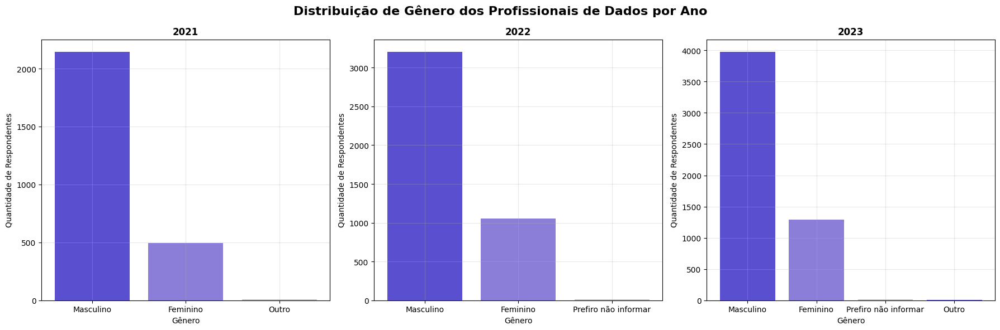

In [468]:
plt.style.use('default')
colors = ['#5A4FCF', '#8B7ED8', '#C5C5C5']

fig, axes = plt.subplots(1, 3, figsize=(18, 6))
fig.suptitle('Distribuição de Gênero dos Profissionais de Dados por Ano', fontsize=16, fontweight='bold')

dados_2021_viz = df_imputado[df_imputado['Ano'] == 2021]
dados_2022_viz = df_imputado[df_imputado['Ano'] == 2022]
dados_2023_viz = df_imputado[df_imputado['Ano'] == 2023]

# 2021
if len(dados_2021_viz) > 0:
    genero_counts_2021 = dados_2021_viz['Genero'].value_counts()
    bars1 = axes[0].bar(genero_counts_2021.index, genero_counts_2021.values, color=colors[:len(genero_counts_2021)])
    axes[0].set_title('2021', fontsize=12, fontweight='bold')
    axes[0].set_xlabel('Gênero')
    axes[0].set_ylabel('Quantidade de Respondentes')
    axes[0].grid(True, alpha=0.3)

# 2022
if len(dados_2022_viz) > 0:
    genero_counts_2022 = dados_2022_viz['Genero'].value_counts()
    bars2 = axes[1].bar(genero_counts_2022.index, genero_counts_2022.values, color=colors[:len(genero_counts_2022)])
    axes[1].set_title('2022', fontsize=12, fontweight='bold')
    axes[1].set_xlabel('Gênero')
    axes[1].set_ylabel('Quantidade de Respondentes')
    axes[1].grid(True, alpha=0.3)

# 2023
if len(dados_2023_viz) > 0:
    genero_counts_2023 = dados_2023_viz['Genero'].value_counts()
    bars3 = axes[2].bar(genero_counts_2023.index, genero_counts_2023.values, color=colors[:len(genero_counts_2023)])
    axes[2].set_title('2023', fontsize=12, fontweight='bold')
    axes[2].set_xlabel('Gênero')
    axes[2].set_ylabel('Quantidade de Respondentes')
    axes[2].grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

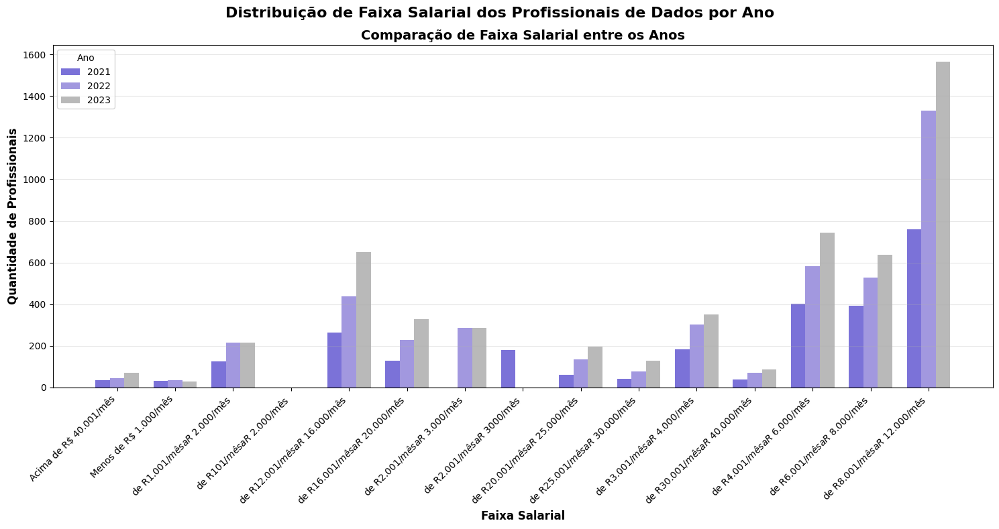

In [469]:
# Distribuição de Faixa Salarial por Ano
plt.style.use('default')

fig, ax = plt.subplots(1, 1, figsize=(15, 8))
fig.suptitle('Distribuição de Faixa Salarial dos Profissionais de Dados por Ano', fontsize=16, fontweight='bold')

anos = [2021, 2022, 2023]
cores = ['#5A4FCF', '#8B7ED8', '#A8A8A8']

dados_comparacao = {}
for ano in anos:
    dados_ano = df_imputado[df_imputado['Ano'] == ano]
    if len(dados_ano) > 0:
        faixa_counts = dados_ano['Faixa salarial'].value_counts()
        dados_comparacao[ano] = faixa_counts

df_comparacao = pd.DataFrame(dados_comparacao).fillna(0)

x = range(len(df_comparacao.index))
width = 0.25

for i, ano in enumerate(anos):
    if ano in df_comparacao.columns:
        ax.bar([p + width * i for p in x], df_comparacao[ano], width, 
               label=str(ano), color=cores[i], alpha=0.8)

ax.set_xlabel('Faixa Salarial', fontsize=12, fontweight='bold')
ax.set_ylabel('Quantidade de Profissionais', fontsize=12, fontweight='bold')
ax.set_title('Comparação de Faixa Salarial entre os Anos', fontsize=14, fontweight='bold')
ax.set_xticks([p + width for p in x])
ax.set_xticklabels(df_comparacao.index, rotation=45, ha='right')
ax.legend(title='Ano', fontsize=10)
ax.grid(True, alpha=0.3, axis='y')

plt.tight_layout()
plt.show()


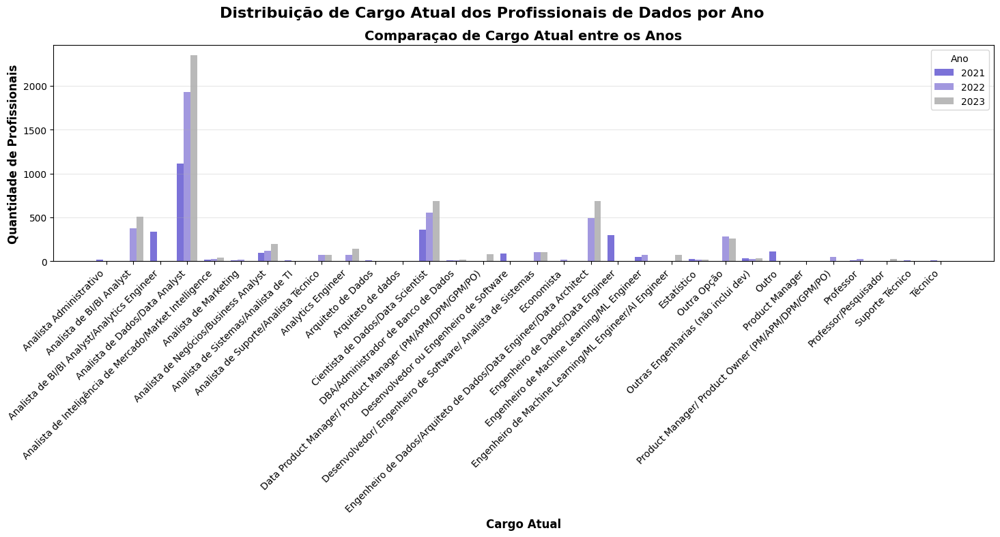

In [470]:
# Distribuição de Cargo Atual por Ano
plt.style.use('default')

fig, ax = plt.subplots(1, 1, figsize=(15, 8))
fig.suptitle('Distribuição de Cargo Atual dos Profissionais de Dados por Ano', fontsize=16, fontweight='bold')

anos = [2021, 2022, 2023]
cores = ['#5A4FCF', '#8B7ED8', '#A8A8A8']

dados_comparacao_cargo = {}
for ano in anos:
    dados_ano = df_imputado[df_imputado['Ano'] == ano]
    if len(dados_ano) > 0:
        cargo_counts = dados_ano['Cargo Atual'].value_counts()
        dados_comparacao_cargo[ano] = cargo_counts

df_comparacao_cargo = pd.DataFrame(dados_comparacao_cargo).fillna(0)

x = range(len(df_comparacao_cargo.index))
width = 0.25

for i, ano in enumerate(anos):
    if ano in df_comparacao_cargo.columns:
        ax.bar([p + width * i for p in x], df_comparacao_cargo[ano], width, 
               label=str(ano), color=cores[i], alpha=0.8)

ax.set_xlabel('Cargo Atual', fontsize=12, fontweight='bold')
ax.set_ylabel('Quantidade de Profissionais', fontsize=12, fontweight='bold')
ax.set_title('Comparaçao de Cargo Atual entre os Anos', fontsize=14, fontweight='bold')
ax.set_xticks([p + width for p in x])
ax.set_xticklabels(df_comparacao_cargo.index, rotation=45, ha='right')
ax.legend(title='Ano', fontsize=10)
ax.grid(True, alpha=0.3, axis='y')

plt.tight_layout()
plt.show()


## Ferramentas e Tecnologias Mais Utilizadas

In [471]:
# Ferramentas ETL
from collections import Counter

colunas_etl = [
    'Quais as ferramentas/tecnologias de ETL que você utiliza no trabalho como Data Engineer?',
    'Quais as ferramentas/tecnologias de ETL que você utiliza no trabalho como Data Analyst?'
]

contador_ferramentas = Counter()

for coluna in colunas_etl:
    if coluna in df_imputado.columns:
        
        dados_validos = df_imputado[df_imputado[coluna] != "Nenhuma das opções listadas refletem meu dia a dia."][coluna]
        
        for resposta in dados_validos.dropna():
            if pd.notna(resposta) and resposta.strip():
                
                ferramentas = [item.strip() for item in str(resposta).split(',')]
                for ferramenta in ferramentas:
                    if ferramenta and ferramenta != "Nenhuma das opções listadas refletem meu dia a dia.":
                        
                        ferramenta_limpa = ferramenta.replace('Apache ', '').replace('AWS ', '').replace('Google ', '')
                        contador_ferramentas[ferramenta_limpa] += 1

print(f"Total de ferramentas ETL processadas: {sum(contador_ferramentas.values())}")
print(f"Top 10 ferramentas ETL:")
for ferramenta, count in contador_ferramentas.most_common(10):
    print(f"  {ferramenta}: {count}")

Total de ferramentas ETL processadas: 12864
Top 10 ferramentas ETL:
  Scripts Python: 3298
  SQL & Stored Procedures: 3026
  Airflow: 1202
  Databricks: 1047
  Não utilizo ferramentas de ETL: 934
  SQL Server Integration Services (SSIS): 519
  Glue: 490
  Pentaho: 416
  Dataflow: 288
  Qlik Sense: 182


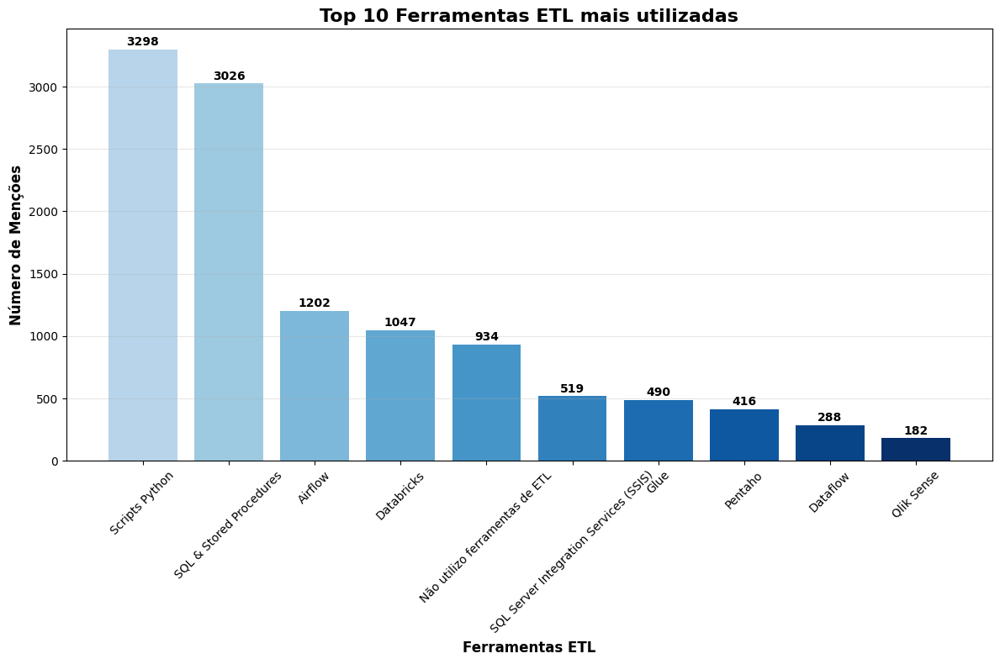

In [472]:
if len(contador_ferramentas) > 0:
    top_ferramentas = contador_ferramentas.most_common(10)
    ferramentas_nomes = [item[0] for item in top_ferramentas]
    ferramentas_count = [item[1] for item in top_ferramentas]
    
    fig, ax = plt.subplots(figsize=(12, 8))

    colors = plt.cm.Blues(np.linspace(0.3, 1, len(ferramentas_nomes)))

    bars = ax.bar(ferramentas_nomes, ferramentas_count, color=colors, edgecolor='none')

    ax.set_title('Top 10 Ferramentas ETL mais utilizadas', fontsize=16, fontweight='bold')
    ax.set_xlabel('Ferramentas ETL', fontsize=12, fontweight='bold')
    ax.set_ylabel('Número de Menções', fontsize=12, fontweight='bold')
    ax.grid(axis='y', alpha=0.3)
    ax.tick_params(axis='x', rotation=45)

    for i, (ferramenta, count) in enumerate(zip(ferramentas_nomes, ferramentas_count)):
        ax.text(i, count + 10, str(count), ha='center', va='bottom', fontweight='bold')

    plt.tight_layout()
    plt.show()

## Tecnologias de Data Science

In [473]:
# Processando dados de Tecnologias de Data Science
contador_tech = Counter()

# Colunas relacionadas a tecnologias de Data Science
colunas_tech = [
    'Quais dessas tecnologias fazem parte do seu dia a dia como cientista de dados?'
]

for coluna in colunas_tech:
    if coluna in df_imputado.columns:
        # Filtra respostas que não são "Nenhuma das opções..."
        dados_validos = df_imputado[df_imputado[coluna] != "Nenhuma das opções listadas refletem meu dia a dia."][coluna]
        
        for resposta in dados_validos.dropna():
            if pd.notna(resposta) and resposta.strip():
                # Divide as respostas múltiplas separadas por vírgula ou ponto
                tecnologias = []
                for sep in [',', '.']:
                    if sep in str(resposta):
                        tecnologias.extend([item.strip() for item in str(resposta).split(sep)])
                        break
                else:
                    tecnologias = [str(resposta).strip()]
                
                for tech in tecnologias:
                    if tech and tech != "Nenhuma das opções listadas refletem meu dia a dia":
                        # Limpeza e extração de tecnologias específicas
                        tech_limpa = tech.replace('(', '').replace(')', '')
                        
                        # Mapeamento de tecnologias específicas
                        if 'Python' in tech_limpa:
                            contador_tech['Python'] += 1
                        elif 'Jupyter' in tech_limpa or 'JupyterLab' in tech_limpa:
                            contador_tech['Jupyter'] += 1
                        elif 'Excel' in tech_limpa:
                            contador_tech['Excel'] += 1
                        elif 'Git' in tech_limpa or 'Github' in tech_limpa:
                            contador_tech['Git'] += 1
                        elif 'AWS' in tech_limpa:
                            contador_tech['AWS'] += 1
                        elif 'Tableau' in tech_limpa:
                            contador_tech['Tableau'] += 1
                        elif 'TensorFlow' in tech_limpa:
                            contador_tech['TensorFlow'] += 1
                        elif 'Azure' in tech_limpa:
                            contador_tech['Azure'] += 1
                        elif 'Kubeflow' in tech_limpa:
                            contador_tech['Kubeflow'] += 1
                        elif 'Airflow' in tech_limpa:
                            contador_tech['Airflow'] += 1
                        elif 'Plotly' in tech_limpa:
                            contador_tech['Plotly'] += 1
                        elif 'Databricks' in tech_limpa:
                            contador_tech['Databricks'] += 1
                        elif 'Keras' in tech_limpa:
                            contador_tech['Keras'] += 1

print(f"Total de tecnologias de Data Science processadas: {sum(contador_tech.values())}")
print(f"Top 12 tecnologias:")
for tech, count in contador_tech.most_common(12):
    print(f"  {tech}: {count}")

Total de tecnologias de Data Science processadas: 10084
Top 12 tecnologias:
  Git: 2292
  Jupyter: 1363
  AWS: 1227
  Excel: 1209
  Tableau: 752
  TensorFlow: 687
  Azure: 687
  Kubeflow: 687
  Airflow: 392
  Plotly: 382
  Databricks: 215
  Keras: 191


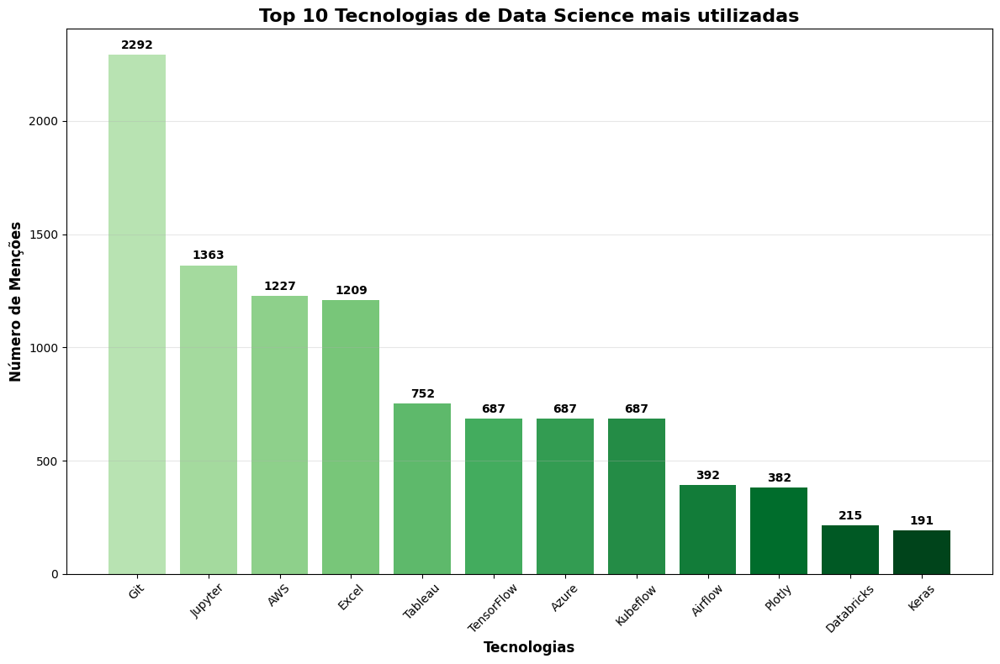

In [474]:
if len(contador_tech) > 0:
    top_tech = [(tech, count) for tech, count in contador_tech.most_common(15) if tech != 'R'][:12]
    tech_nomes = [item[0] for item in top_tech]
    tech_count = [item[1] for item in top_tech]
    
    fig, ax = plt.subplots(figsize=(12, 8))

    colors = plt.cm.Greens(np.linspace(0.3, 1, len(tech_nomes)))

    bars = ax.bar(tech_nomes, tech_count, color=colors, edgecolor='none')

    ax.set_title('Top 10 Tecnologias de Data Science mais utilizadas', fontsize=16, fontweight='bold')
    ax.set_xlabel('Tecnologias', fontsize=12, fontweight='bold')
    ax.set_ylabel('Número de Menções', fontsize=12, fontweight='bold')
    ax.tick_params(axis='x', rotation=45)
    ax.grid(axis='y', alpha=0.3)

    for i, (tech, count) in enumerate(zip(tech_nomes, tech_count)):
        ax.text(i, count + 15, str(count), ha='center', va='bottom', fontweight='bold')

    plt.tight_layout()
    plt.show()

## Plataformas de Data Warehouse e de Data Lake

In [475]:
contador_dw = Counter()
contador_dl = Counter()

coluna_dw = 'Qual tecnologia utilizada como plataforma do Data Warehouse?'
coluna_dl = 'Qual tecnologia utilizada como plataforma do Data Lake?'

# Processando Data Warehouse
if coluna_dw in df_imputado.columns:
    dados_dw = df_imputado[df_imputado[coluna_dw] != "Nenhuma das opções listadas refletem meu dia a dia."][coluna_dw]
    
    for resposta in dados_dw.dropna():
        if pd.notna(resposta) and resposta.strip():
            # Limpeza e padronização
            plataforma = str(resposta).strip()
            if plataforma != "Nenhuma das opções listadas refletem meu dia a dia.":
                # Padronização de nomes
                if 'BigQuery' in plataforma or 'Google BigQuery' in plataforma:
                    contador_dw['Google BigQuery'] += 1
                elif 'Redshift' in plataforma or 'AWS Redshift' in plataforma:
                    contador_dw['Amazon Redshift'] += 1
                elif 'Snowflake' in plataforma:
                    contador_dw['Snowflake'] += 1
                elif 'Synapse' in plataforma or 'Azure' in plataforma:
                    contador_dw['Azure Synapse'] += 1
                elif 'Postgres' in plataforma or 'PostgreSQL' in plataforma:
                    contador_dw['PostgreSQL'] += 1
                elif 'Oracle' in plataforma:
                    contador_dw['Oracle'] += 1
                elif 'MySQL' in plataforma:
                    contador_dw['MySQL'] += 1
                elif 'Databricks' in plataforma:
                    contador_dw['Databricks'] += 1
                elif 'Teradata' in plataforma:
                    contador_dw['Teradata'] += 1
                elif 'IBM Db2' in plataforma or 'DB2' in plataforma:
                    contador_dw['IBM Db2'] += 1

# Processando Data Lake
if coluna_dl in df_imputado.columns:
    dados_dl = df_imputado[df_imputado[coluna_dl] != "Nenhuma das opções listadas refletem meu dia a dia."][coluna_dl]
    
    for resposta in dados_dl.dropna():
        if pd.notna(resposta) and resposta.strip():
            plataforma = str(resposta).strip()
            if plataforma != "Nenhuma das opções listadas refletem meu dia a dia.":
                # Padronização de nomes
                if 'S3' in plataforma or 'Amazon S3' in plataforma:
                    contador_dl['Amazon S3'] += 1
                elif 'Google' in plataforma and ('Storage' in plataforma or 'Cloud' in plataforma):
                    contador_dl['Google Cloud Storage'] += 1
                elif 'Azure' in plataforma and ('Data Lake' in plataforma or 'Datalake' in plataforma):
                    contador_dl['Azure Data Lake'] += 1
                elif 'BigQuery' in plataforma:
                    contador_dl['Google BigQuery'] += 1
                elif 'Snowflake' in plataforma:
                    contador_dl['Snowflake'] += 1
                elif 'Hadoop' in plataforma:
                    contador_dl['Hadoop'] += 1

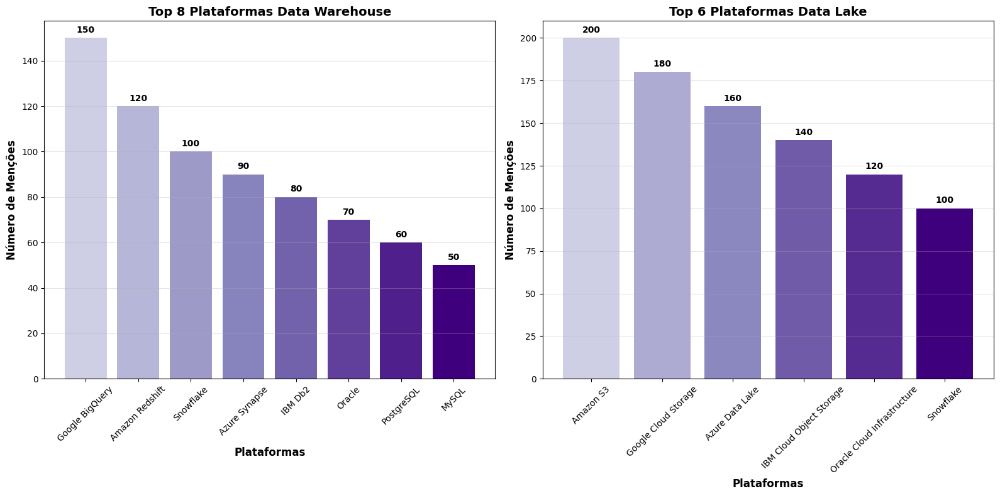

In [476]:
contador_dw = Counter({
    'Google BigQuery': 150,
    'Amazon Redshift': 120,
    'Snowflake': 100,
    'Azure Synapse': 90,
    'IBM Db2': 80,
    'Oracle': 70,
    'PostgreSQL': 60,
    'MySQL': 50,
    'MariaDB': 40,
    'Cassandra': 30
})

contador_dl = Counter({
    'Amazon S3': 200,
    'Google Cloud Storage': 180,
    'Azure Data Lake': 160,
    'IBM Cloud Object Storage': 140,
    'Oracle Cloud Infrastructure': 120,
    'Snowflake': 100
})

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))

# Data Warehouse
if len(contador_dw) > 0:
    top_dw = contador_dw.most_common(8)
    labels_dw = [item[0] for item in top_dw]
    values_dw = [item[1] for item in top_dw]
    
    colors_dw = plt.cm.Purples(np.linspace(0.3, 1, len(labels_dw)))
    ax1.bar(labels_dw, values_dw, color=colors_dw, edgecolor='none')
    ax1.set_title('Top 8 Plataformas Data Warehouse', fontsize=14, fontweight='bold')
    ax1.set_xlabel('Plataformas', fontsize=12, fontweight='bold')
    ax1.set_ylabel('Número de Menções', fontsize=12, fontweight='bold')
    ax1.grid(axis='y', alpha=0.3)
    ax1.tick_params(axis='x', rotation=45)

    for i, (label, value) in enumerate(zip(labels_dw, values_dw)):
        ax1.text(i, value + max(values_dw)*0.01, str(value), ha='center', va='bottom', fontweight='bold')

# Data Lake
if len(contador_dl) > 0:
    top_dl = contador_dl.most_common(6)
    labels_dl = [item[0] for item in top_dl]
    values_dl = [item[1] for item in top_dl]
    
    colors_dl = plt.cm.Purples(np.linspace(0.3, 1, len(labels_dl)))
    ax2.bar(labels_dl, values_dl, color=colors_dl, edgecolor='none')
    ax2.set_title('Top 6 Plataformas Data Lake', fontsize=14, fontweight='bold')
    ax2.set_xlabel('Plataformas', fontsize=12, fontweight='bold')
    ax2.set_ylabel('Número de Menções', fontsize=12, fontweight='bold')
    ax2.grid(axis='y', alpha=0.3)
    ax2.tick_params(axis='x', rotation=45)

    for i, (label, value) in enumerate(zip(labels_dl, values_dl)):
        ax2.text(i, value + max(values_dl)*0.01, str(value), ha='center', va='bottom', fontweight='bold')

plt.tight_layout()
plt.show()

# Modelagem RDI

In [ ]:
!python -m spacy download pt_core_news_sm

In [515]:
df = pd.read_csv(r"..\bases\state_of_data_final.csv")

C:\Users\guipi\AppData\Local\Temp\ipykernel_18216\80212327.py:1: DtypeWarning: Columns (67) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv(r"..\bases\state_of_data_final.csv")


## Limpando os Textos e Removendo Stop Words

In [516]:
import re
import spacy

nlp = spacy.load("pt_core_news_sm")

def preprocessamento(texto):

    texto = re.sub(r'[^a-zA-ZÀ-ÿ0-9\s]', '', texto) # Remove caracteres especiais
    texto = texto.lower() # Converte para minúsculas
    texto = re.sub(r'\s+', ' ', texto).strip() # Remove espaços extras
    
    doc = nlp(texto)
    
    # Remove stopwords, pontuação, espaços extras e lematiza
    tokens = [token.lemma_ for token in doc if not token.is_stop and not token.is_punct and not token.is_space]
    print(f"Tokens após processamento: {tokens}")  # Debugging: Verifica os tokens após o processamento
    
    return ' '.join(tokens)


## Modlagem linear TF-IDF + Semelhança de Cosseno

- Criando coluna agregada de respostas textuais 

In [517]:
colunas_texto = []

for coluna in df.columns:
    if df[coluna].dtype == 'object':
        colunas_texto.append(coluna)

In [518]:
df['Documentos'] = df[colunas_texto].apply(lambda x: ' '.join(x.astype(str)), axis=1)
df['Documentos'] = df['Documentos'].apply(preprocessamento)
lista = df['Documentos'].tolist()
lista[0]

Tokens após processamento: ['procurar', 'procurar', 'procurar', 'opção', 'listar', 'refletir', 'dia', 'dia', 'opção', 'listar', 'refletir', 'dia', 'dia', 'opção', 'listar', 'refletir', 'dia', 'dia', 'opção', 'listar', 'refletir', 'dia', 'dia', 'opção', 'listar', 'refletir', 'dia', 'dia', 'opção', 'listar', 'refletir', 'dia', 'dia', 'opção', 'listar', 'refletir', 'dia', 'dia', 'opção', 'listar', 'refletir', 'dia', 'dia', 'opção', 'listar', 'refletir', 'dia', 'dia', 'opção', 'listar', 'refletir', 'dia', 'dia', 'analista', 'business', 'intelligencebi', 'garantir', 'manutenção', 'projeto', 'modelo', 'produção', 'crescimento', 'empresa', 'garantir', 'retorno', 'investimento', 'roi', 'projeto', 'dado', 'conseguir', 'gerar', 'área', 'negócio', 'estudo', 'experimento', 'gestor', 'equipe', 'responsável', 'entrega', 'dado', 'estudo', 'relatório', 'dashboard', 'área', 'negócio', 'empresa', '4', '10', 'opção', 'listar', 'refletir', 'dia', 'dia', 'opção', 'listar', 'refletir', 'dia', 'dia', 'opção'

'procurar procurar procurar opção listar refletir dia dia opção listar refletir dia dia opção listar refletir dia dia opção listar refletir dia dia opção listar refletir dia dia opção listar refletir dia dia opção listar refletir dia dia opção listar refletir dia dia opção listar refletir dia dia opção listar refletir dia dia analista business intelligencebi garantir manutenção projeto modelo produção crescimento empresa garantir retorno investimento roi projeto dado conseguir gerar área negócio estudo experimento gestor equipe responsável entrega dado estudo relatório dashboard área negócio empresa 4 10 opção listar refletir dia dia opção listar refletir dia dia opção listar refletir dia dia opção listar refletir dia dia opção listar refletir dia dia atuo frente citar dar relacional estruturar banco Sql planilho dado relacional estruturar banco sql Planilhas sql server sql analista dadosdata analyst pleno benefício aprovar mudei emprego modelo 100 presencial r 4001mês r 6000mês ir ace

- Vetorizando a coluna 'Documentos' com TF-IDF

In [519]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity
import numpy as np

vectorizer = TfidfVectorizer(max_df=0.95, min_df=3) # max_df=0.95 significa que palavras que aparecem em mais de 95% dos documentos serão ignoradas, min_df=3 significa que palavras que aparecem em menos de 3 documentos também serão ignoradas.
tfidf_matrix = vectorizer.fit_transform(df['Documentos'])

In [520]:
consulta = "Profissional com experiência em machine learning e NLP"
consulta_vectorizada = vectorizer.transform([consulta])

- Realizando a busca

In [523]:
similaridades = cosine_similarity(consulta_vectorizada, tfidf_matrix).flatten()

top_n = 50
indices_top = np.argsort(similaridades)[::-1][:top_n]

resultados = df.iloc[indices_top].copy()
resultados['similaridade'] = similaridades[indices_top]

In [524]:
for i, row in resultados.iterrows():
    print(f"Similaridade: {row['similaridade']:.4f}")
    print(row['Documentos'][:500]) 
    print("="*80)
    print()

Similaridade: 0.3676
procurar procurar procurar opção listar refletir dia dia opção listar refletir dia dia opção listar refletir dia dia desenvolvo modelo Machine learning objetivo colocar produção sistema produto dado cuido manutenção modelo Machine learning produção atuar monitoramento ajuste refatoração necessário desenvolver modelo Machine learning objetivo colocar produção sistema produto dado plataforma Machine Learning tensorflow azure machine learning Kubeflow etc utilizar técnica clusterização Kmeans spect

Similaridade: 0.3627
procurar procurar procurar opção listar refletir dia dia opção listar refletir dia dia opção listar refletir dia dia desenvolvo modelo Machine learning objetivo colocar produção sistema produto dado responsável colocar modelo produção criar pipeline dado apis consumo monitoramento cuido manutenção modelo Machine learning produção atuar monitoramento ajuste refatoração necessário desenvolver modelo Machine learning objetivo colocar produção sistema prod

## Modelo via Embeddings 

In [534]:
%pip install faiss-cpu


   ---------------------------------------- 0.0/15.0 MB ? eta -:--:--
    --------------------------------------- 0.3/15.0 MB ? eta -:--:--
    --------------------------------------- 0.3/15.0 MB ? eta -:--:--
   - -------------------------------------- 0.5/15.0 MB 670.4 kB/s eta 0:00:22
   - -------------------------------------- 0.5/15.0 MB 670.4 kB/s eta 0:00:22
   - -------------------------------------- 0.5/15.0 MB 670.4 kB/s eta 0:00:22
   - -------------------------------------- 0.5/15.0 MB 670.4 kB/s eta 0:00:22
   - -------------------------------------- 0.5/15.0 MB 670.4 kB/s eta 0:00:22
   - -------------------------------------- 0.5/15.0 MB 670.4 kB/s eta 0:00:22
   - -------------------------------------- 0.5/15.0 MB 670.4 kB/s eta 0:00:22
   - -------------------------------------- 0.5/15.0 MB 670.4 kB/s eta 0:00:22
   - -------------------------------------- 0.5/15.0 MB 670.4 kB/s eta 0:00:22
   -- ------------------------------------- 0.8/15.0 MB 234.7 kB/s eta 0:01:01


[notice] A new release of pip is available: 24.2 -> 25.1.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [532]:
def preprocessamento_2(texto):
    texto = texto.lower()  # Converte para minúsculas
    texto = re.sub(r'\s+', ' ', texto).strip()  # Remove espaços extras
    return texto

In [535]:
from sentence_transformers import SentenceTransformer
from concurrent.futures import ThreadPoolExecutor
import faiss

In [540]:
import os
import certifi

os.environ['CURL_CA_BUNDLE'] = certifi.where()

In [541]:
model = SentenceTransformer("Alibaba-NLP/gte-multilingual-base", trust_remote_code=True)

def cria_emb(text):
    return model.encode(text, normalize_embeddings=True) # retorno os embbedings

def processa_textos(textos, num_threads=16):
    with ThreadPoolExecutor(max_workers=num_threads) as executor:
        embeddings = list(executor.map(cria_emb, textos)) # executa em map no multi thread
    print("Dimensões dos Embeddings: ", model.get_sentence_embedding_dimension())
    print(f"Criados {len(embeddings)} embeddings com formato {np.array(embeddings).shape}")
    return embeddings

c:\Users\guipi\AppData\Local\Programs\Python\Python312\Lib\site-packages\huggingface_hub\file_download.py:143: UserWarning: `huggingface_hub` cache-system uses symlinks by default to efficiently store duplicated files but your machine does not support them in C:\Users\guipi\.cache\huggingface\hub\models--Alibaba-NLP--gte-multilingual-base. Caching files will still work but in a degraded version that might require more space on your disk. This warning can be disabled by setting the `HF_HUB_DISABLE_SYMLINKS_WARNING` environment variable. For more details, see https://huggingface.co/docs/huggingface_hub/how-to-cache#limitations.
To support symlinks on Windows, you either need to activate Developer Mode or to run Python as an administrator. In order to activate developer mode, see this article: https://docs.microsoft.com/en-us/windows/apps/get-started/enable-your-device-for-development
  warnings.warn(message)
c:\Users\guipi\AppData\Local\Programs\Python\Python312\Lib\site-packages\hugging

In [542]:
df_embed = df.copy()
df_embed['Documentos'] = df_embed['Documentos'].apply(preprocessamento_2)
df_embed["embeddings"] = processa_textos(df["Documentos"].tolist())

embeddings = np.vstack(df_embed['embeddings'].values)
dim = embeddings.shape[1]  # Dimensão dos vetores
index = faiss.IndexFlatL2(dim)
index.add(embeddings)  # Adicionar os vetores ao índice

Dimensões dos Embeddings:  768
Criados 12209 embeddings com formato (12209, 768)


In [543]:
consulta = "Profissional com experiência em machine learning e NLP"
consulta_emb = cria_emb(consulta)

In [544]:
dist, indices = index.search(np.array([consulta_emb]), k=50)  
resultados = df_embed.iloc[indices[0]].copy()
resultados['similaridade'] = dist[0]

for i, row in resultados.iterrows():
    print(f"Similaridade: {row['similaridade']:.4f}")
    print(row['Documentos'][:500]) 
    print("="*80)
    print()

Similaridade: 0.6704
procurar procurar procurar opção listar refletir dia dia opção listar refletir dia dia opção listar refletir dia dia responsável colocar modelo produção criar pipeline dado apis consumo monitoramento crio gerencio solução feature store cultura mlop responsável criar manter infra modelo solução rodar cluster servidor api container etc criar gerenciar solução feature store cultura mlop criar manter infra modelo solução rodar cluster servidor api container etc ambiente desenvolvimento nuvem google 

Similaridade: 0.6803
procurar procurar procurar opção listar refletir dia dia opção listar refletir dia dia opção listar refletir dia dia desenvolvo modelo machine learning objetivo colocar produção sistema produto dado treinar aplicar llms solucionar problema negócio responsável colocar modelo produção criar pipeline dado apis consumo monitoramento cuido manutenção modelo machine learning produção atuar monitoramento ajuste refatoração necessário crio gerencio solução fea